# Color Image Quantization
Reduce the number of colors in images (`lena.png`, `peppers.tif`) to 16 using K-means clustering, implemented from scratch. Log L2 norms per iteration and optionally visualize quantized images.

In [12]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

In [13]:
def kmeans_quantization(image, k=16, max_iterations=100, visualize=False):
    """Perform K-means color quantization on an image.
    
    Args:
        image: Input image (H, W, 3) as float32 in [0, 1].
        k: Number of clusters (colors).
        max_iterations: Maximum number of iterations.
        visualize: If True, display quantized image per iteration.
    
    Returns:
        quantized_image: Image with k colors.
        l2_norms: List of L2 norms per iteration.
    """
    # 1. Reshape image to list of pixels (N, 3)
    height, width, channels = image.shape
    pixels = image.reshape(-1, 3)# Reshape the image from 3D (height × width × channels) into a 2D array where each row represents a pixel (num_pixels × 3)
    num_pixels = pixels.shape[0]

    # 2. Initialize centroids randomly from pixels
    random_generator = np.random.default_rng(42) # Random number generator
    indices = random_generator.choice(num_pixels, size=k, replace=False) # Pick k unique random pixels
    centroids = pixels[indices] # Use those pixels as the initial centroids

    # Store L2 norm (error) for each iteration
    l2_norms = []
    for it in range(max_iterations):
        # 3. Assign pixels to nearest centroid (L2 norm)
        distances = np.linalg.norm(pixels[:, None] - centroids[None, :], axis=2) # distances shape: (num_pixels, num_clusters)
        pixel_labels = np.argmin(distances, axis=1) # Assign cluster index with minimum distance

        # 4. Update centroids
        # If a cluster has no pixels, keep the old centroid
        new_centroids = np.array([pixels[pixel_labels == i].mean(axis=0) if np.any(pixel_labels == i) else centroids[i] for i in range(k)])

        # 5. Reconstruct quantized image
        quantized_pixels = centroids[pixel_labels] # Replace each pixel's RGB value with the RGB value of its assigned centroid
        quantized_image = quantized_pixels.reshape(height, width, channels) # Reshape the quantized pixels back to the original image dimensions

        # 6. Compute and log the L2 error between original and quantized image
        l2 = calculate_l2_norm(image, quantized_image)
        l2_norms.append(l2)

        # 7. Visualization (optional) -> show quantized image for each iteration
        if visualize:
            plt.imshow(quantized_image)
            plt.title(f'Iteration {it+1}, L2={l2:.2f}')
            plt.axis('off')
            plt.show()

        # 8. Check for convergence –> stop if centroids do not change significantly
        if np.allclose(new_centroids, centroids, atol=1e-5):
            break
        centroids = new_centroids # Update centroids for the next iteration

    return quantized_image, l2_norms # Return the final quantized image and error history

In [14]:
def calculate_l2_norm(original, quantized):
    """Calculate total L2 norm between original and quantized images.
    
    Args:
        original: Original image (H, W, 3) as float32 in [0, 1].
        quantized: Quantized image (H, W, 3) as float32 in [0, 1].
    
    Returns:
        l2_norm: Total L2 norm across all pixels.
    """

    diff = original - quantized # Compute pixel-wise difference between the two images
    return np.sqrt(np.sum(diff ** 2)) # Square the differences, sum over all pixels and channels, then take the square root and return it

In [15]:
# Load images
image_path = 'images\lena.png'
image = cv2.imread(image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB).astype(np.float32) / 255.0

# Parameters
k = 16
max_iterations = 100
visualize = True

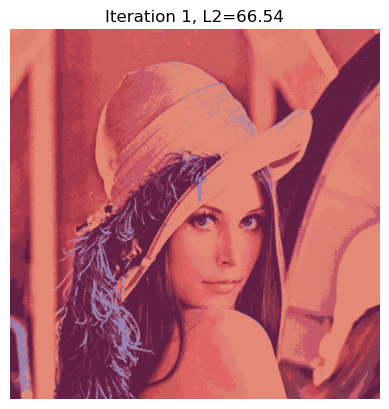

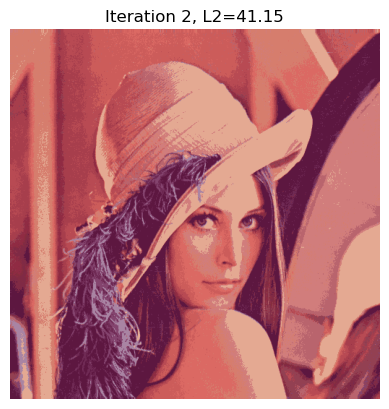

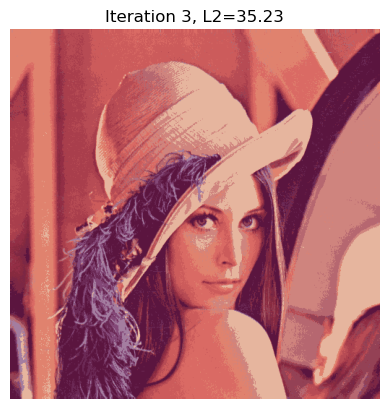

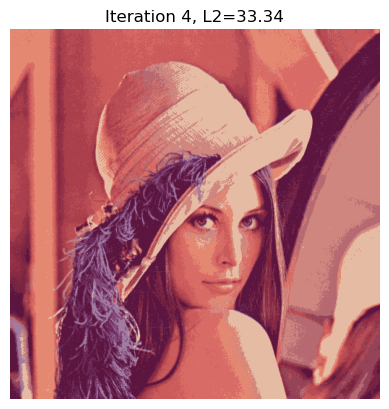

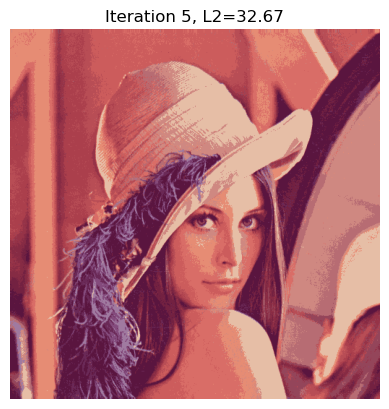

...

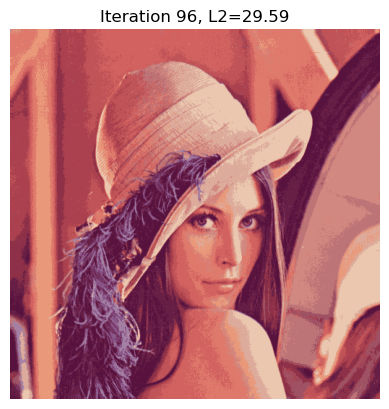

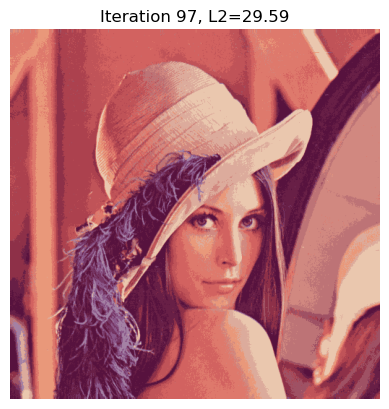

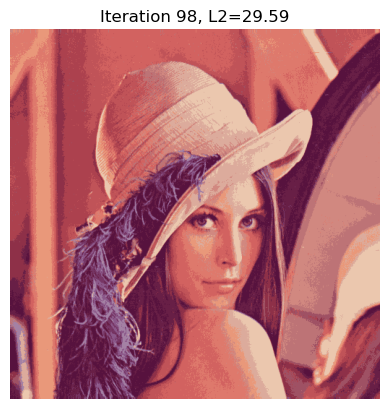

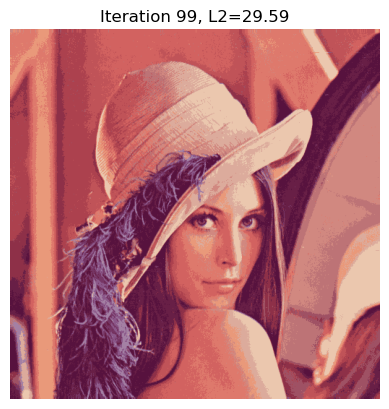

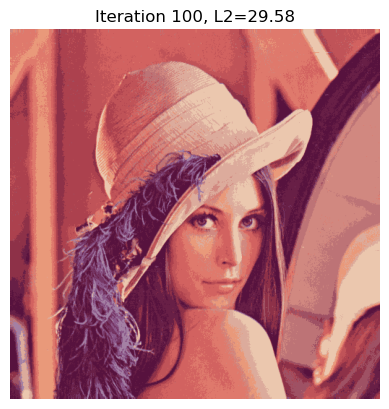

Total L2 Norm: 29.58


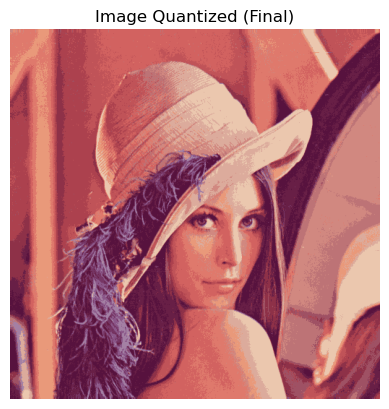

True

In [16]:
# Process image
# Returns the quantized image and a list of L2 norms per iteration
image_quantized, image_l2_norms = kmeans_quantization(image, k, max_iterations, visualize) 

# Save the L2 norms log to a text file
with open('L2_norm_log.txt', 'w') as f:
    f.write('Image L2 Norms:\n' + '\n'.join(map(str, image_l2_norms)) + '\n')

# Final L2 norm
image_l2 = calculate_l2_norm(image, image_quantized)
print(f'Total L2 Norm: {image_l2:.2f}')

# Show result
plt.imshow(image_quantized)
plt.title('Image Quantized (Final)')
plt.axis('off')
plt.show()

# Save quantized image
# Multiply by 255 and convert to uint8 because cv2.imwrite expects 0-255 BGR image
cv2.imwrite('images\lena_quantized.png', cv2.cvtColor((image_quantized * 255).astype(np.uint8), cv2.COLOR_RGB2BGR))